In [25]:
import sklearn
import matplotlib.pyplot as plt
import pandas as pd
import pyspark
import pandas as pd
from pyspark.sql.types import *
import numpy as np
from pyspark.sql import SparkSession
import sys
import math
import matplotlib.pyplot as plt

In [65]:
#generate the datasets
from sklearn.datasets import make_blobs

n_samples = 85000 

X, y = make_blobs( n_samples = n_samples, centers = 3)

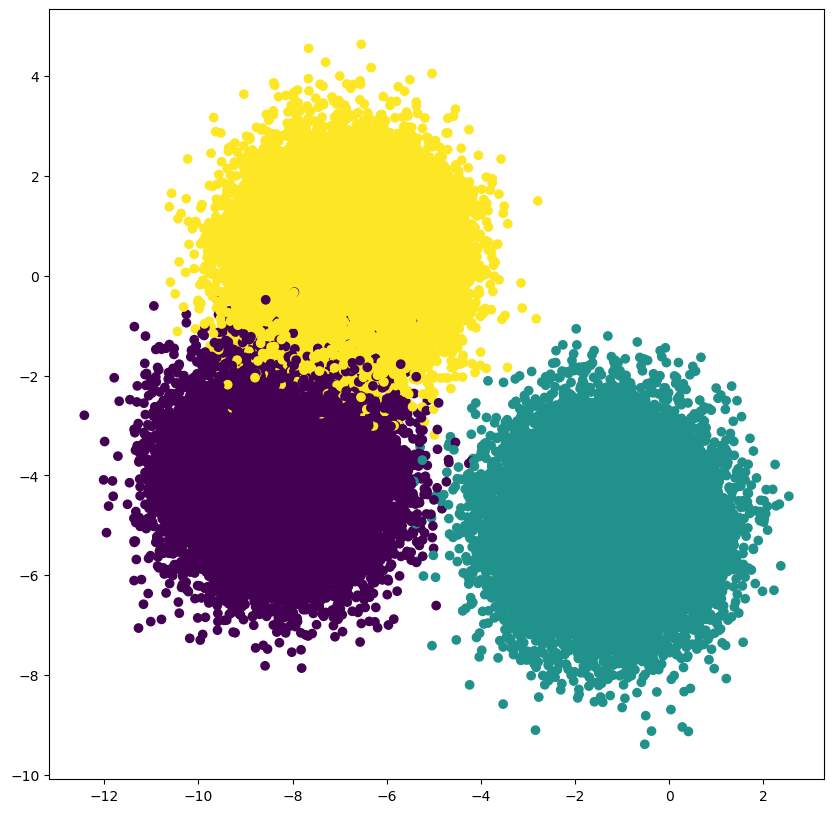

In [66]:
plt.figure(figsize=(10, 10))
plt.scatter(X[:, 0], X[:, 1], c=y)

In [67]:
spark=SparkSession.builder.appName('firstapp').getOrCreate()

In [68]:
#Add index


data = spark.createDataFrame(pd.DataFrame(X))
# data = data.drop('Name')
df = data.toPandas()
df_index = pd.DataFrame({'index': range(0, len(df))})
result_df = pd.concat([df, df_index], axis=1)
data = spark.createDataFrame(result_df)

In [69]:
#select randomly centers

centers = data.toPandas().sample(n=3)
print(centers)

              0         1  index
23649 -4.911781  0.682836  23649
31580 -7.572334 -0.597545  31580
5822  -8.749173 -3.043207   5822


In [70]:
#Mapper function
cols = [item for item in data.columns if(item != 'index')]
def map(x, cent):
    minDist = sys.float_info.max
    index = -1
    for i, center in cent.iterrows():
        distCenter = euclideanDistance(x, center)
        if(minDist > distCenter):
             minDist = distCenter
             index = int(center['index'])
        y = x.asDict()
        # del y['index']
        y['num'] = 1
        toSave = Row(**y)
    return (index, toSave)
def euclideanDistance(x, y):
    dist = 0
    for dim in cols:
        dist = dist + (float(x[dim]) - float(y[dim]))**2
    dist = math.sqrt(dist)
    return dist

# rdd = data.rdd.map(lambda x: map(x)).groupByKey()
# e = rdd.toDF()
# for f in e.collect():
#     print(f)

In [71]:
#reducer function
def reduce(a, b):
    c = {}
    for column in cols:
        c[column] = float(a[column]) + float(b[column])
    c['num'] = float(a['num']) + float(b['num'])
    toSave = Row(**c)
    return toSave
def computeMean(y):
    g = y[1].asDict()
    for col in cols:
        g[col] = g[col]/g['num']
    g['index'] = int(y[0])
    return Row(**g)

In [72]:
#Excetution of parallel k-means for 10 iteration
valueObjFunc = []
current = 0
previous = 0
for i in range(0, 10):
    mapResult = data.rdd.map(lambda x: map(x, centers))
    # for value in mapResult.collect():
    #     print(value)
    reduceResult = mapResult.reduceByKey(lambda a,b: reduce(a, b)).map(lambda q: computeMean(q))
    e = reduceResult.toDF()
    # for f in e.collect():
    #     print(f)
    error = mapResult.map(lambda x: (1, euclideanDistance(x[1], centers[centers['index'] == int(x[0])].iloc[0]))).reduceByKey(lambda a,b: a+b)
    for p in error.collect():
        print(p)
        previous = current
        current = p[1]
        valueObjFunc.append(p[1])
    centers = e.toPandas()
    # print()
    # print()
print(valueObjFunc)

(1, 272814.4651055336)


(1, 139534.97106733394)


(1, 106017.73277718485)


(1, 105984.24250810962)


(1, 105983.89126639122)


(1, 105983.90370327861)


(1, 105983.90681159172)


(1, 105983.90681159172)


(1, 105983.90681159172)


(1, 105983.90681159172)
[272814.4651055336, 139534.97106733394, 106017.73277718485, 105984.24250810962, 105983.89126639122, 105983.90370327861, 105983.90681159172, 105983.90681159172, 105983.90681159172, 105983.90681159172]


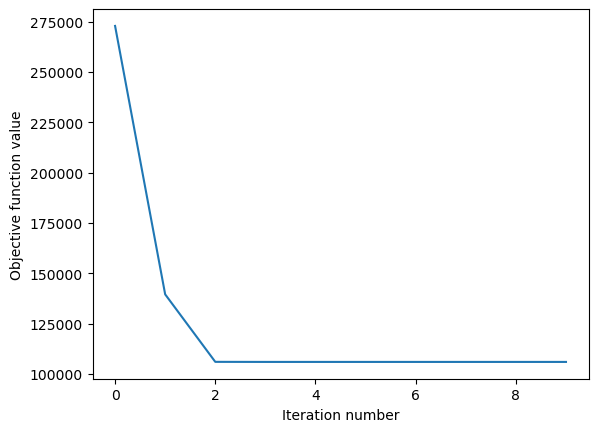

In [73]:
#loss over the iterations
plt.plot(valueObjFunc)
plt.xlabel("Iteration number")
plt.ylabel("Objective function value")
plt.show()

In [74]:
clusterClass = mapResult.toDF().toPandas()
df = pd.DataFrame(columns=['X', 'Y', 'C', ])
for i, center in clusterClass.iterrows():
    df.loc[len(df.index)] = [center[1][0], center[1][1], center[0]]
    #tup = {'X':center[1][0],'Y':center[1][1], 'C':center[0]}
    #df.append(tup, ignore_index=True)
print(df)

/tmp/ipykernel_70132/849658517.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df.loc[len(df.index)] = [center[1][0], center[1][1], center[0]]
/tmp/ipykernel_70132/849658517.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df.loc[len(df.index)] = [center[1][0], center[1][1], center[0]]
/tmp/ipykernel_70132/849658517.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df.loc[len(df.index)] = [center[1][0], center[1][1], center

              X         Y        C
0     -8.316797 -3.711438   5822.0
1     -7.367731 -0.310245  31580.0
2     -6.738108 -0.141579  31580.0
3     -2.038060 -5.581496  23649.0
4      0.394796 -4.889392  23649.0
...         ...       ...      ...
84995 -1.113763 -5.547686  23649.0
84996 -6.215929  1.772277  31580.0
84997 -1.925721 -4.904438  23649.0
84998 -6.367562 -4.750856   5822.0
84999 -9.278186 -3.946736   5822.0

[85000 rows x 3 columns]


/tmp/ipykernel_70132/849658517.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df.loc[len(df.index)] = [center[1][0], center[1][1], center[0]]
/tmp/ipykernel_70132/849658517.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df.loc[len(df.index)] = [center[1][0], center[1][1], center[0]]
/tmp/ipykernel_70132/849658517.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df.loc[len(df.index)] = [center[1][0], center[1][1], center

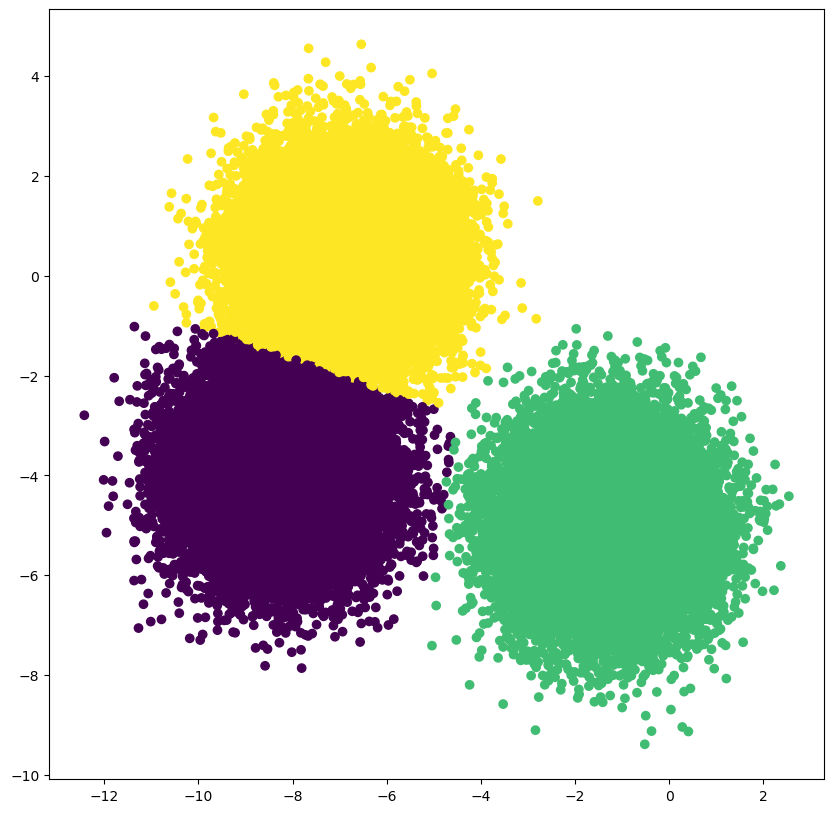

In [76]:
#Cluster give by the algorithm

np = df.to_numpy()
plt.figure(figsize=(10, 10))
plt.scatter(np[:, 0], np[:, 1], c=np[:, 2])